In [1]:
import os
os.chdir("/Coding/Spectrum4Geo/") #Change to ProjectDirectory (One Directory above)

In [7]:
import os
import torch
import pickle
import importlib
import numpy as np
import matplotlib.pyplot as plt
from dataclasses import dataclass
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
from torchvision.transforms.functional import resize

from spectrum4geo.dataset.training import SatSpectroTrainDataset
from spectrum4geo.dataset.evaluation import SatEvalDataset, SpectroEvalDataset
from spectrum4geo.transforms import get_transforms_val_sat, get_transforms_val_spectro
from spectrum4geo.transforms import get_transforms_train_sat, get_transforms_train_spectro 
importlib.reload(spectrum4geo.transforms)
importlib.reload(spectrum4geo.dataset.training)
importlib.reload(spectrum4geo.dataset.evaluation)
from spectrum4geo.dataset.training import SatSpectroTrainDataset
from spectrum4geo.dataset.evaluation import SatEvalDataset, SpectroEvalDataset
from spectrum4geo.transforms import get_transforms_val_sat, get_transforms_val_spectro
from spectrum4geo.transforms import get_transforms_train_sat, get_transforms_train_spectro 

@dataclass
class Configuration:
    img_size: int = 384         # for satallite images
    patch_time_steps = 1024     # Image size for spectograms (Width)
    n_mels = 128                # image size for spectograms (Height)
    sr_kHz = 48
    batch_size: int = 48        # keep in mind real_batch_size = 2 * batch_size
    data_folder = "data"        # Dataset
    # Augment Images
    prob_rotate: float = 0.75          # rotates the sat image 
    prob_flip: float = 0.5             # flipping the sat image 
    num_workers: int = 0 if os.name == 'nt' else 4 
    device: str = 'cuda' if torch.cuda.is_available() else 'cpu' 
    mean=[1, 1, 1]
    std=[1, 1, 1]

    # Shuffeling test
    shuffeling = True
    neighbour_select: int = 64                  # max selection size from pool
    neighbour_range: int = 128                  # pool size for selection
    gps_dict_path: str = 'data/gps_dict.pkl'    # path to pre-computed distances
    

config = Configuration()

img_size = config.img_size
img_size_sat = (img_size, img_size)
img_size_spectro = (config.patch_time_steps, config.n_mels)

# Transforms
sat_transforms_train = get_transforms_train_sat(img_size_sat,
                                                mean=config.mean,
                                                std=config.std,
                                                )

spectro_transforms_train = get_transforms_train_spectro(img_size_spectro,
                                                        mean=config.mean,
                                                        std=config.std,
                                                        )

train_dataset = SatSpectroTrainDataset(data_folder=config.data_folder ,
                                       split_csv='train_df.csv',
                                       transforms_sat_image=sat_transforms_train,
                                       transforms_spectrogram=spectro_transforms_train,
                                       patch_time_steps=config.patch_time_steps,
                                       sr_kHz=config.sr_kHz,
                                       n_mels=config.n_mels,
                                       prob_flip=config.prob_flip,
                                       prob_rotate=config.prob_rotate,
                                       shuffle_batch_size=config.batch_size
                                       )
              

train_dataloader = DataLoader(train_dataset,
                              batch_size=12,  
                              shuffle=True,
                              num_workers=config.num_workers,
                              pin_memory=True
                              )

if config.shuffeling:
        with open(config.gps_dict_path, 'rb') as f:
            sim_dict = pickle.load(f)

        train_dataloader.dataset.shuffle(sim_dict,
                                         neighbour_select=config.neighbour_select,
                                         neighbour_range=config.neighbour_range
                                         )            

# Eval
sat_transforms_val = get_transforms_val_sat(img_size_sat,
                                            mean=config.mean,
                                            std=config.std,
                                            )

spectro_transforms_val = get_transforms_val_spectro(mean=config.mean,       
                                                    std=config.std
                                                    )    

# Satellite Images
sat_dataset_test = SatEvalDataset(data_folder=config.data_folder ,
                                  split_csv='test_df.csv',
                                  transforms=sat_transforms_val,
                                  )

sat_dataloader_test = DataLoader(sat_dataset_test,
                                 batch_size=config.batch_size,
                                 num_workers=config.num_workers,
                                 shuffle=False,
                                 pin_memory=True
                                 )

# Spectogram Images
spectro_dataset_test = SpectroEvalDataset(data_folder=config.data_folder ,
                                          split_csv='test_df.csv',
                                          transforms=spectro_transforms_val,
                                          patch_time_steps=config.patch_time_steps,
                                          sr_kHz=config.sr_kHz,
                                          n_mels=config.n_mels,
                                          )

spectro_dataloader_test = DataLoader(spectro_dataset_test,
                                     batch_size=config.batch_size,
                                     num_workers=config.num_workers,
                                     shuffle=False,
                                     pin_memory=True
                                     )

print("Sat Images Test:", len(sat_dataset_test))
print("Spectrogram Images Test:", len(spectro_dataset_test))
    
dataloader_val_tup = (spectro_dataloader_test, sat_dataloader_test)

/home/j0kr0017/conda/lib/python3.12/site-packages/pydantic/main.py:328: UserWarning: Pydantic serializer warnings:
  Expected `Union[float, tuple[float, float]]` but got `list` - serialized value may not be as expected
  Expected `Union[float, tuple[float, float]]` but got `list` - serialized value may not be as expected
  Expected `Union[float, tuple[float, float]]` but got `list` - serialized value may not be as expected
  Expected `Union[float, tuple[float, float]]` but got `list` - serialized value may not be as expected
  return self.__pydantic_serializer__.to_python(



Shuffle Dataset:


35626it [00:00, 67855.95it/s]                           


idx_pool: 0
Original Length: 35625 - Length after Shuffle: 35616
Break Counter: 70
Pairs left out of last batch to avoid creating noise: 9
First Element ID: 28087 - Last Element ID: 31505
Sat Images Test: 10179
Spectrogram Images Test: 10179


In [8]:
importlib.reload(spectrum4geo.transforms)
importlib.reload(spectrum4geo.dataset.training)
importlib.reload(spectrum4geo.dataset.evaluation)
from spectrum4geo.dataset.training import SatSpectroTrainDataset
from spectrum4geo.dataset.evaluation import SatEvalDataset, SpectroEvalDataset
from spectrum4geo.transforms import get_transforms_val_sat, get_transforms_val_spectro
from spectrum4geo.transforms import get_transforms_train_sat, get_transforms_train_spectro  

# Spectogram Images [CHUNKED]
spectro_dataset_test_chunked = SpectroEvalDataset(data_folder=config.data_folder ,
                                    split_csv='test_df.csv',
                                    transforms=spectro_transforms_val,
                                    patch_time_steps=config.patch_time_steps,
                                    sr_kHz=config.sr_kHz,
                                    n_mels=config.n_mels,
                                    chunking=True,
                                    stride=config.patch_time_steps//2
                                    )

spectro_dataloader_test_chunked = DataLoader(spectro_dataset_test_chunked,
                                    batch_size=config.batch_size,
                                    num_workers=config.num_workers,
                                    shuffle=False,
                                    pin_memory=True
                                    )

Precalculating amount of chunks:   7%|▋         | 760/10179 [00:03<00:45, 205.68it/s]


KeyboardInterrupt: 

Plotte Train Dataloader Bilder

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


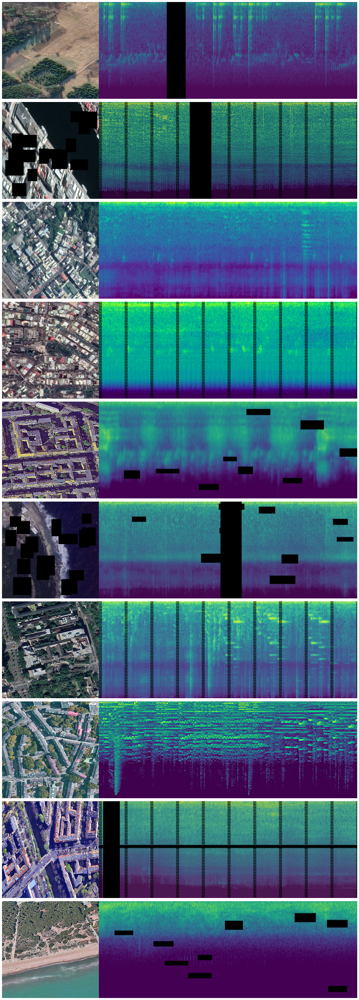

In [5]:
def denormalize(tensor, mean, std):
    for t, m, s in zip(tensor, mean, std):
        t.mul_(s).add_(m)
    return tensor

def plot_images(dataloader, num_images,  spectro_den_b = True, sat_den_b = True):
    fig, axs = plt.subplots(nrows=num_images, ncols=1, figsize=(20, 5 * num_images))  
    axs = axs.flatten() 

    sat_images, spectrograms, _ = next(iter(dataloader))  
    image_count = 0

    for sat_image, spectrogram in zip(sat_images, spectrograms):
        if sat_den_b:
            sat_image = denormalize(sat_image, config.mean, config.std)
        if spectro_den_b:
            spectrogram = denormalize(spectrogram, config.mean, config.std)
            #spectrogram = (spectrogram + )    # to convert 

        target_height = sat_image.shape[1]  
        spectrogram_resized = resize(spectrogram, (target_height, spectrogram.shape[-1]))
        combined_image = torch.cat((sat_image, spectrogram_resized), dim=2)  

        ax = axs[image_count]
        ax.imshow(combined_image.permute(1, 2, 0).numpy())  
        ax.axis('off')  
        image_count += 1

        if image_count >= num_images:
            break

    plt.tight_layout()
    plt.show()

plot_images(train_dataloader, 10, spectro_den_b = True, sat_den_b = True)

Plotte Eval Dataloader Bilder

Picture: 1, Satellite Image Label ID: 0, Spectrogram Label ID: 0
Picture: 2, Satellite Image Label ID: 1, Spectrogram Label ID: 1
Picture: 3, Satellite Image Label ID: 2, Spectrogram Label ID: 2


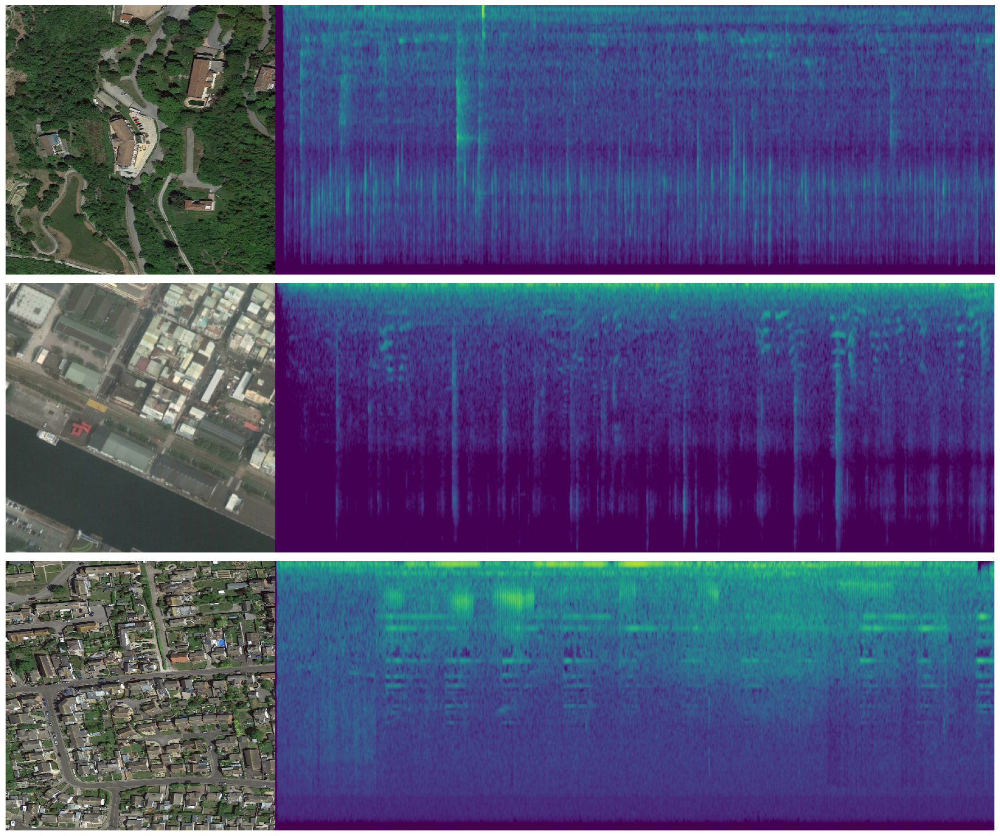

In [6]:
def plot_images_dls(dataloader_tup, num_images, spectro_den_b=True, sat_den_b=True):
    fig, axs = plt.subplots(nrows=num_images, ncols=1, figsize=(20, 5 * num_images))
    axs = axs.flatten()

    dataloader_spec, dataloader_sat = dataloader_tup  
    spectrograms, label_spec = next(iter(dataloader_spec))
    sat_images, label_sat = next(iter(dataloader_sat))

    image_count = 0
    for sat_image, spectrogram, label_sat, label_spec in zip(sat_images, spectrograms, label_sat, label_spec):
        if sat_den_b:
            sat_image = denormalize(sat_image, config.mean, config.std)
        if spectro_den_b:
            spectrogram = denormalize(spectrogram, config.mean, config.std)

        target_height = sat_image.shape[1]  
        spectrogram_resized = resize(spectrogram, (target_height, spectrogram.shape[-1]))

        combined_image = torch.cat((sat_image, spectrogram_resized), dim=2)  

        ax = axs[image_count]
        ax.imshow(combined_image.permute(1, 2, 0).numpy())  
        ax.axis('off')  

        image_count += 1

        # print labels of the combined image
        print(f'Picture: {image_count}, Satellite Image Label ID: {label_sat}, Spectrogram Label ID: {label_spec}')

        if image_count >= num_images:
            break

    plt.tight_layout()
    plt.show()

plot_images_dls(dataloader_val_tup, 3,  spectro_den_b = True, sat_den_b = True)

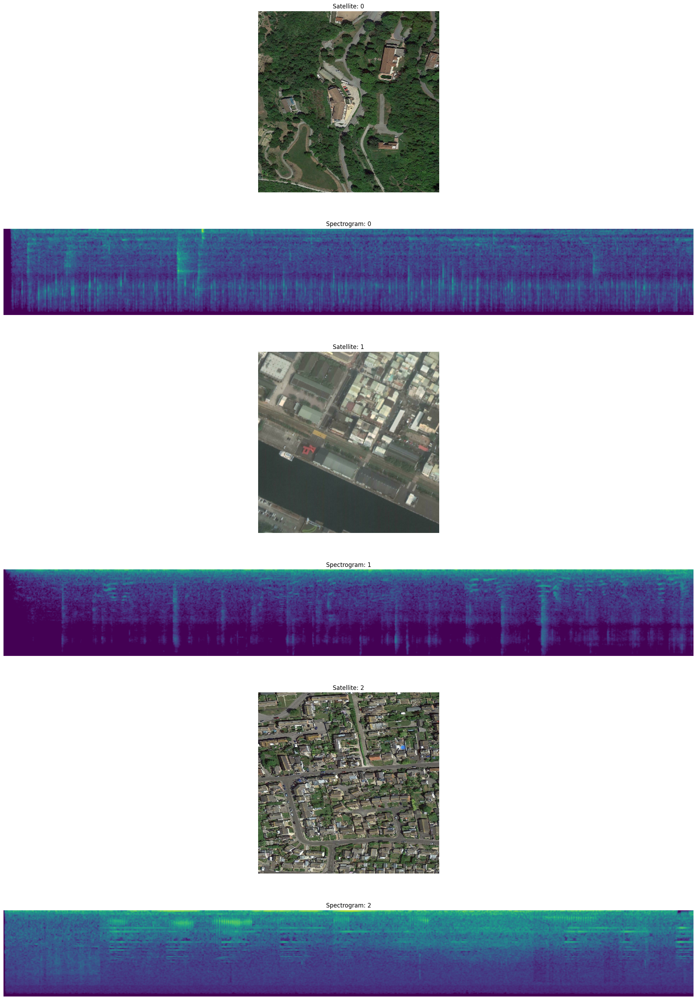

In [7]:
def plot_images_singular(dataloader_tup, num_images, spectro_den_b=True, sat_den_b=True):
    fig, axs = plt.subplots(nrows=num_images*2, ncols=1, figsize=(20, 10 * num_images))  
    axs = axs.flatten()  

    dataloader_spec, dataloader_sat = dataloader_tup  
    spectrograms, label_spec = next(iter(dataloader_spec))
    sat_images, label_sat = next(iter(dataloader_sat))

    image_count = 0
    for sat_image, spectrogram, label_sat, label_spec in zip(sat_images, spectrograms, label_sat, label_spec):
        if sat_den_b:
            sat_image = denormalize(sat_image, config.mean, config.std)
        if spectro_den_b:
            spectrogram = denormalize(spectrogram, config.mean, config.std)

        ax1 = axs[2 * image_count]
        ax1.imshow(sat_image.permute(1, 2, 0).numpy())  
        ax1.axis('off')
        ax1.set_title(f'Satellite: {label_sat}')

        ax2 = axs[2 * image_count + 1]
        ax2.imshow(spectrogram.permute(1, 2, 0).numpy()) 
        ax2.axis('off')
        ax2.set_title(f'Spectrogram: {label_spec}')

        image_count += 1

        if image_count >= num_images:
            break

    plt.tight_layout()
    plt.show()

plot_images_singular(dataloader_val_tup, 3,  spectro_den_b = True, sat_den_b = True)

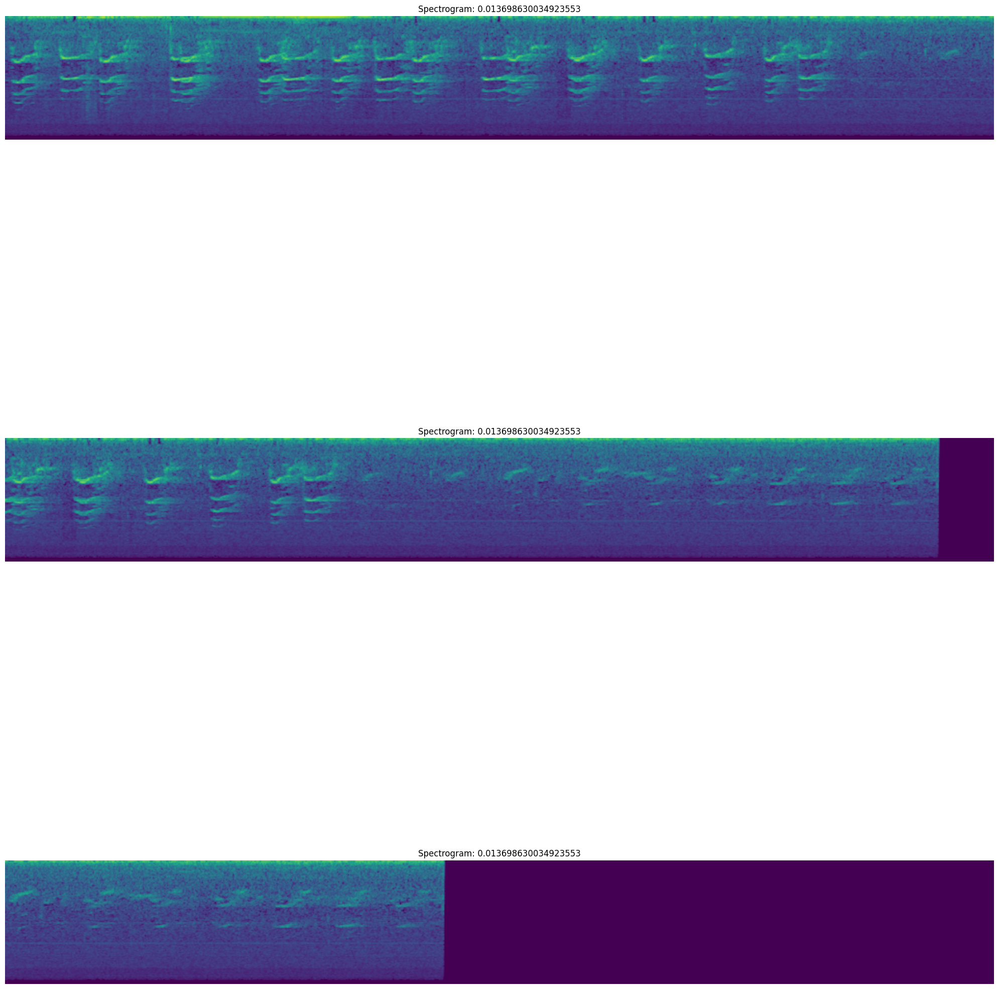

In [40]:
def plot_spektros(dataset, num_images, spectro_den_b=True):
    fig, axs = plt.subplots(nrows=num_images, ncols=1, figsize=(20, 10 * num_images)) 
    axs = axs.flatten() 

    image_count = 0
    #diter = iter(spectro_dataloader_test_chunked)
    #spectrograms, label_ids, weights = next(diter)
    #for spectrogram, label_id, w in zip(spectrograms, label_ids):
    test = 247
    for idx in range(test, test + num_images):
        spectrogram, _, label_id = dataset[idx]
        if spectro_den_b:
            spectrogram = denormalize(spectrogram, config.mean, config.std)

        ax = axs[image_count]
        axs[image_count].imshow(spectrogram.permute(1, 2, 0).numpy()) 
        axs[image_count].axis('off')
        axs[image_count].set_title(f'Spectrogram: {label_id}')

        image_count += 1

        if image_count >= num_images:
            break

    plt.tight_layout()
    plt.show()

plot_spektros(spectro_dataloader_test_chunked.dataset, 3,  spectro_den_b = True)